In [ ]:
! pip install --upgrade scipy

In [6]:
%load_ext autoreload
%autoreload 2

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


In [7]:
import cv2
import numpy as np
import os
import matplotlib.pyplot as plt
from tqdm import tqdm

In [8]:
from fuzzylib import *

### Fuzzy Pixels - representation demo

CPU times: user 15 ms, sys: 1.31 ms, total: 16.4 ms
Wall time: 15.8 ms


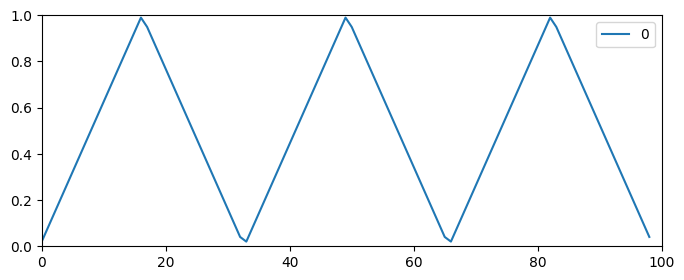

In [9]:
%%time
r1 = FuzzyColor((255, 255, 255))
r1.plot()

CPU times: user 11.1 ms, sys: 679 µs, total: 11.8 ms
Wall time: 11.4 ms


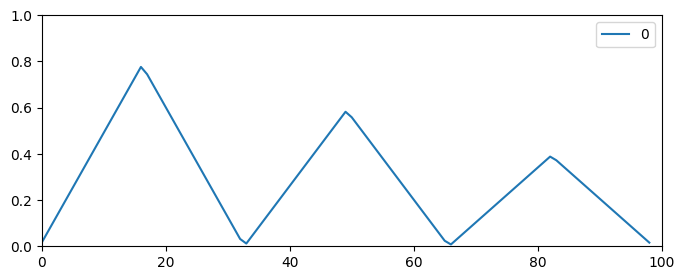

In [10]:
%%time
r2 = FuzzyColor((200, 150, 100))
r2.plot()

CPU times: user 14.4 ms, sys: 718 µs, total: 15.2 ms
Wall time: 14.8 ms


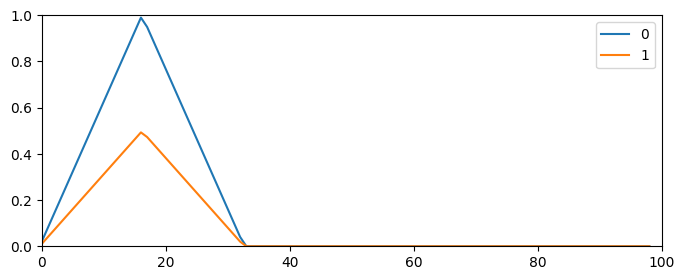

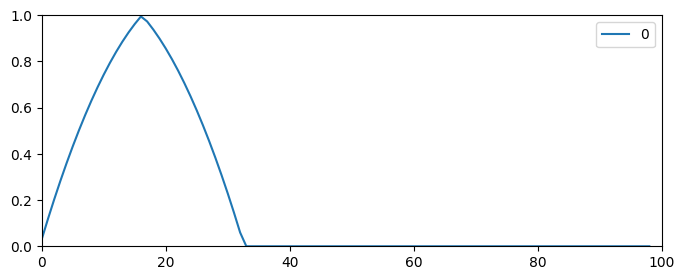

In [11]:
%%time
r1 = FuzzyColor((255, 0, 0))
r2 = FuzzyColor((127, 0, 0))
show(r1, r2)
show(r1+r2)

({'r': 200, 'g': 0, 'b': 0},
 {'r': 0, 'g': 200, 'b': 0},
 {'r': 200, 'g': 200, 'b': 0})

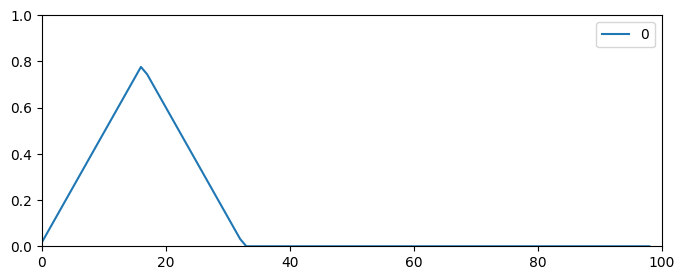

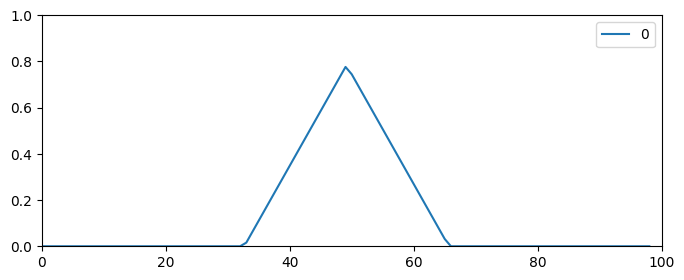

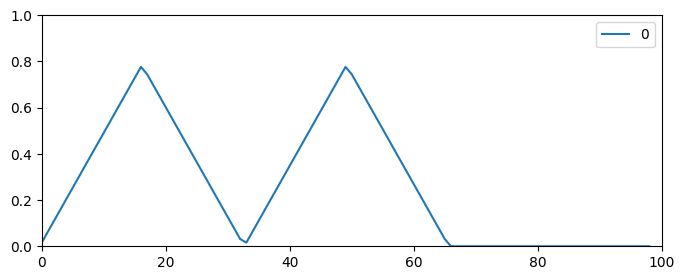

In [12]:
red = FuzzyColor((200, 0, 0), tri_min)
green = FuzzyColor((0, 200, 0), tri_min)
red_green = red + green
red.plot()
green.plot()
red_green.plot()
(red, green, red_green)

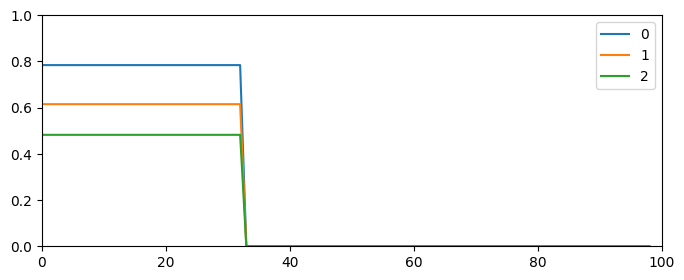

In [13]:
# Block representation function
red = FuzzyColor((200, 0, 0), fn=block)
show(red, red.power(2), red.power(3))

#### Fuzzy colorization algorithm

In [14]:
from multiprocessing import Pool
def test_and_compare_parallel(tests, max_h, noise_level, conorm_fn, cores=2):
    per_core = round(len(tests)/cores + 0.49)
    
    per_core_arguments = []
    for i in range(0, cores):
        per_core_arguments.append((tests[i*per_core: (i+1)*per_core], max_h, noise_level, conorm_fn))
    
    print(per_core_arguments)
    with Pool(cores) as pool:
        grids = pool.starmap(test_and_compare, per_core_arguments)
        grid = np.hstack(grids)
    return grid

In [16]:
max_h = 80
conorm_fn = conorm_prod
noise_level = 0.5
cpus=5

## Triangle representation

#### Control lightness with conorms

[(['ball.jpg'], 120, 0.5, <function conorm_less_than_prod at 0x12eeefd90>), (['dog.jpg'], 120, 0.5, <function conorm_less_than_prod at 0x12eeefd90>), (['colorize.jpg'], 120, 0.5, <function conorm_less_than_prod at 0x12eeefd90>), (['car.jpg'], 120, 0.5, <function conorm_less_than_prod at 0x12eeefd90>), (['laptop.jpg'], 120, 0.5, <function conorm_less_than_prod at 0x12eeefd90>)]


100%|██████████| 1/1 [01:07<00:00, 67.29s/it]


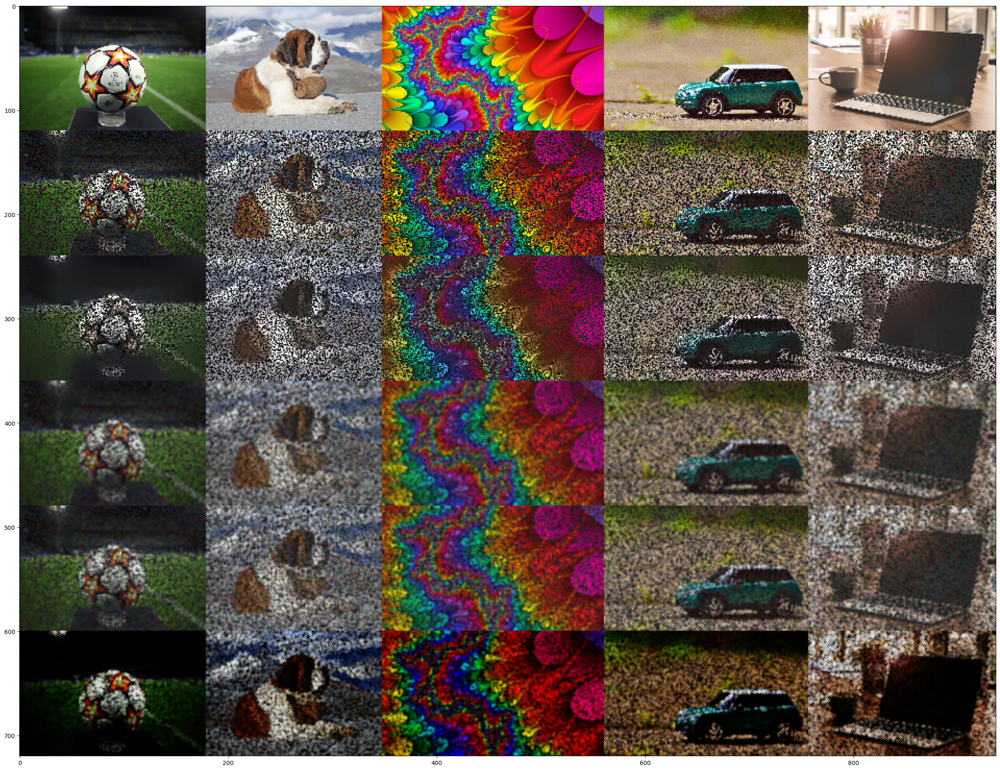

CPU times: user 2.96 s, sys: 986 ms, total: 3.95 s
Wall time: 1min 10s


In [19]:
%%time
# Conorm - dark
size = 120
noise_level = 0.5
fig_size = (30, 30)
tests = ['ball.jpg', 'dog.jpg', 'colorize.jpg', 'car.jpg', 'laptop.jpg']
grid = test_and_compare_parallel(tests, size, noise_level, conorm_less_than_prod, cpus)
show_rgb(grid, figsize=fig_size)

[(['ball.jpg'], 120, 0.5, <function conorm_prod at 0x12f098040>), (['dog.jpg'], 120, 0.5, <function conorm_prod at 0x12f098040>), (['colorize.jpg'], 120, 0.5, <function conorm_prod at 0x12f098040>), (['car.jpg'], 120, 0.5, <function conorm_prod at 0x12f098040>), (['laptop.jpg'], 120, 0.5, <function conorm_prod at 0x12f098040>)]


100%|██████████| 1/1 [01:01<00:00, 61.66s/it]


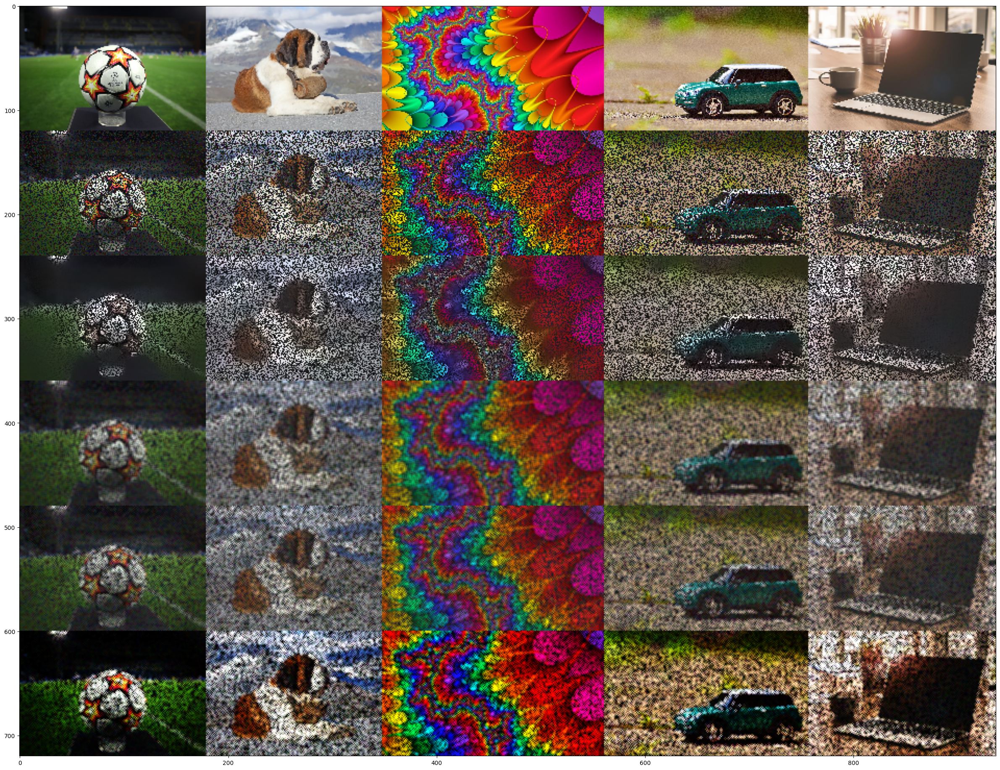

CPU times: user 2.7 s, sys: 1.28 s, total: 3.98 s
Wall time: 1min 4s


In [22]:
%%time
# Conorm - standard colors
grid = test_and_compare_parallel(tests, size, noise_level, conorm_prod, cpus)
show_rgb(grid, figsize=fig_size)

[(['ball.jpg'], 120, 0.5, <function conorm_einstein_sum at 0x12eeefd00>), (['dog.jpg'], 120, 0.5, <function conorm_einstein_sum at 0x12eeefd00>), (['colorize.jpg'], 120, 0.5, <function conorm_einstein_sum at 0x12eeefd00>), (['car.jpg'], 120, 0.5, <function conorm_einstein_sum at 0x12eeefd00>), (['laptop.jpg'], 120, 0.5, <function conorm_einstein_sum at 0x12eeefd00>)]


100%|██████████| 1/1 [01:02<00:00, 62.40s/it]


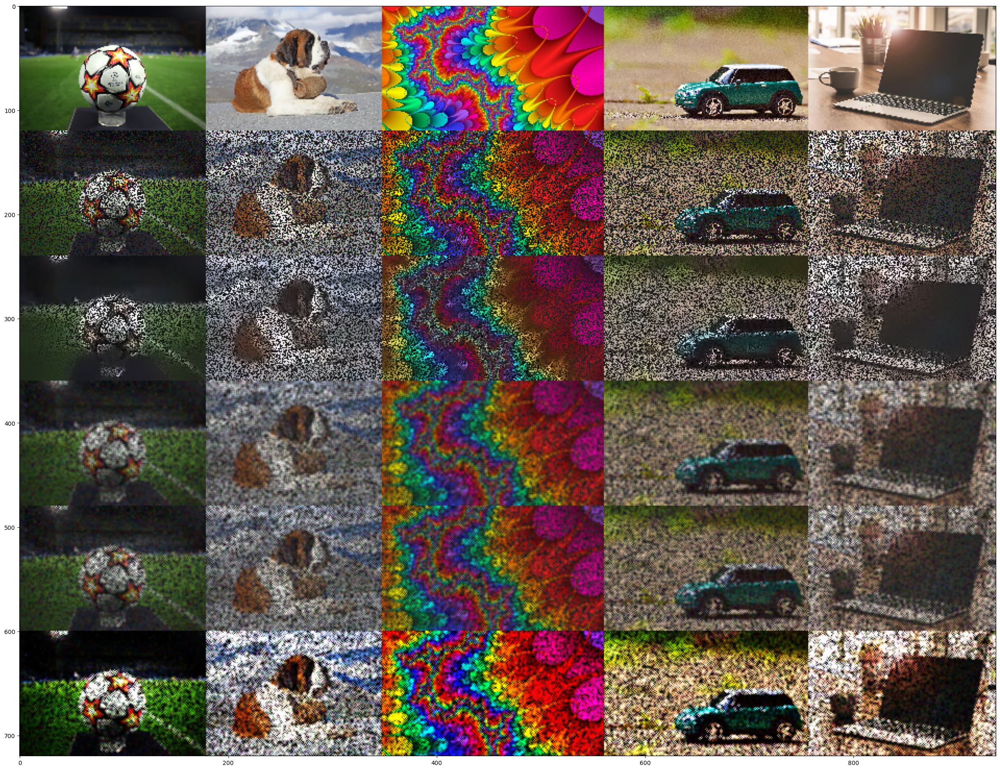

CPU times: user 2.77 s, sys: 1.25 s, total: 4.02 s
Wall time: 1min 5s


In [23]:
%%time
# Conorm - light
grid = test_and_compare_parallel(tests, size, noise_level, conorm_einstein_sum, cpus)
show_rgb(grid, figsize=fig_size)

#### Performance on different levels of noise

[(['ball.jpg'], 80, 0.25, <function conorm_more_than_prod at 0x1280f2560>), (['dog.jpg'], 80, 0.25, <function conorm_more_than_prod at 0x1280f2560>), (['colorize.jpg'], 80, 0.25, <function conorm_more_than_prod at 0x1280f2560>), (['car.jpg'], 80, 0.25, <function conorm_more_than_prod at 0x1280f2560>), (['laptop.jpg'], 80, 0.25, <function conorm_more_than_prod at 0x1280f2560>)]


100%|██████████| 1/1 [00:28<00:00, 28.97s/it]


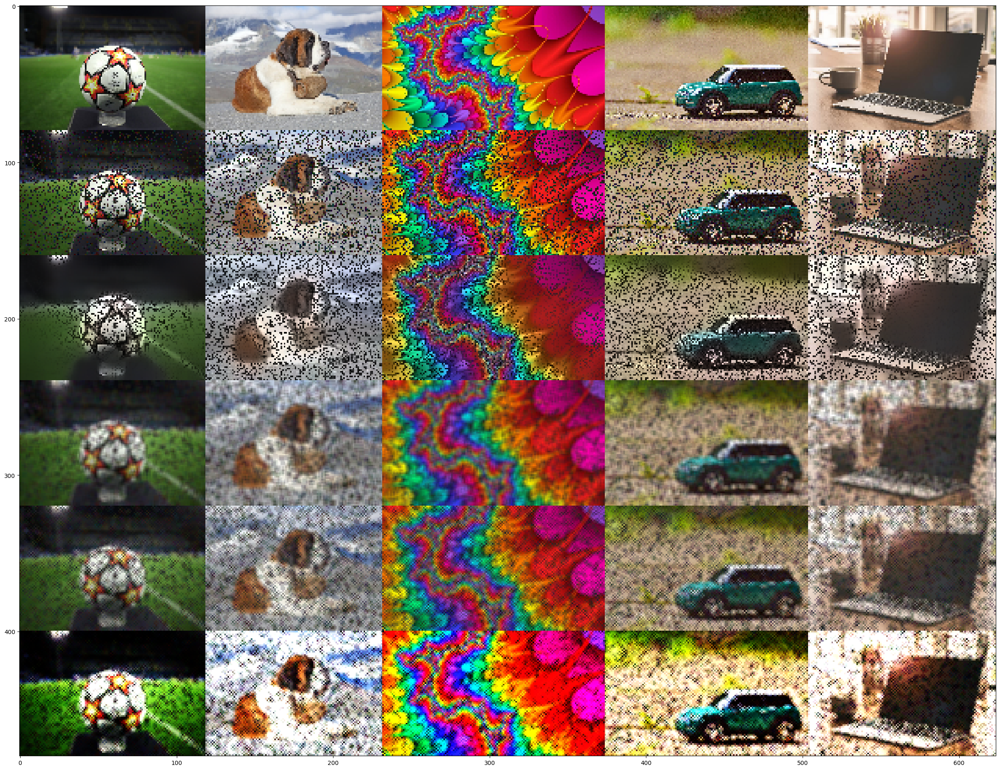

CPU times: user 1.04 s, sys: 1.29 s, total: 2.33 s
Wall time: 30.1 s


In [13]:
%%time
# Little noise
grid = test_and_compare_parallel(tests, 80, 0.25, conorm_more_than_prod, cpus)
show_rgb(grid, figsize=fig_size)

[(['ball.jpg'], 100, 0.75, <function conorm_more_than_prod at 0x1280f2560>), (['dog.jpg'], 100, 0.75, <function conorm_more_than_prod at 0x1280f2560>), (['colorize.jpg'], 100, 0.75, <function conorm_more_than_prod at 0x1280f2560>), (['car.jpg'], 100, 0.75, <function conorm_more_than_prod at 0x1280f2560>), (['laptop.jpg'], 100, 0.75, <function conorm_more_than_prod at 0x1280f2560>)]


100%|██████████| 1/1 [00:42<00:00, 42.58s/it]


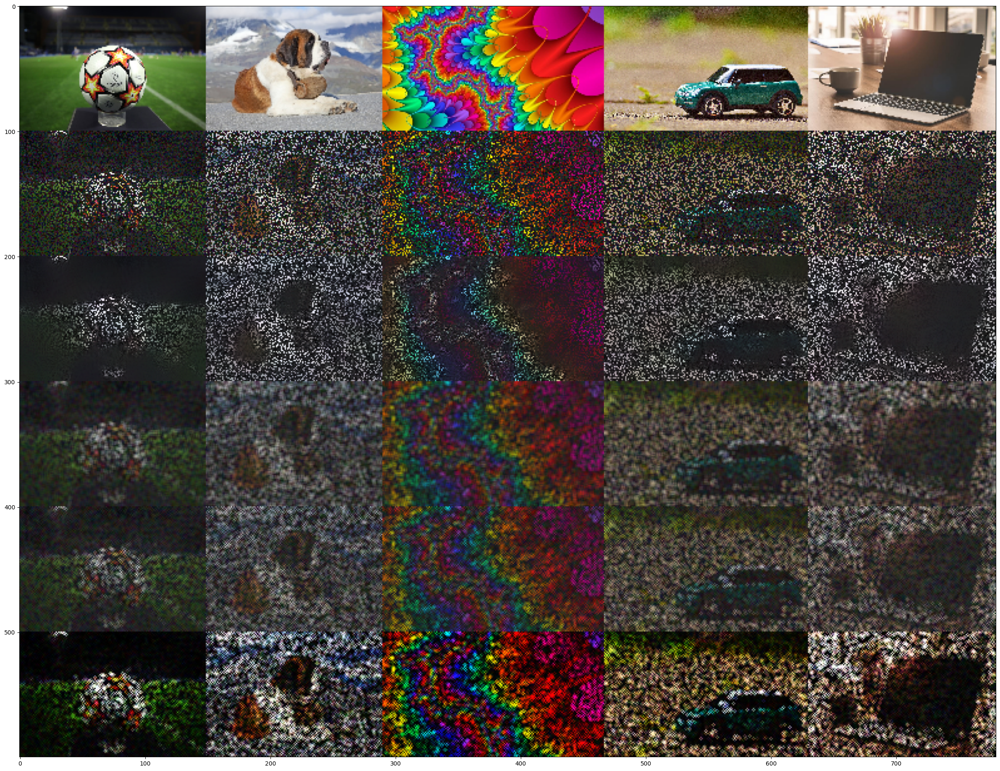

CPU times: user 2.76 s, sys: 1.41 s, total: 4.17 s
Wall time: 45.6 s


In [12]:
%%time
# Lot of noise
grid = test_and_compare_parallel(tests, 80, 0.75, conorm_more_than_prod, cpus)
show_rgb(grid, figsize=fig_size)

#### Test with EfficientNet V2 model

In [136]:
# Prepare data
for t in tqdm(tests):
    max_h = 160
    grid = test_and_compare([t], max_h, 0.5, conorm_fn)
    input_image = grid[:max_h, :]

    noise_image = grid[max_h:max_h*2, :]
    nl_image = grid[(max_h*2):(max_h*3), :]
    blur_image = grid[(max_h*3):(max_h*4), :]
    fuzzy_denoise_image = grid[(max_h*5):, :]
    crisp_denoise_image = crisp_denoise(noise_image)

    cv2.imwrite(f'{t}_noise.jpg', cv2.cvtColor(noise_image, cv2.COLOR_BGR2RGB))
    cv2.imwrite(f'{t}_nl.jpg', cv2.cvtColor(nl_image, cv2.COLOR_BGR2RGB))
    cv2.imwrite(f'{t}_blur.jpg', cv2.cvtColor(blur_image, cv2.COLOR_BGR2RGB))
    cv2.imwrite(f'{t}_fuzzy.jpg', cv2.cvtColor(fuzzy_denoise_image, cv2.COLOR_BGR2RGB))

100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [48:55<00:00, 293.57s/it]


In [137]:
import tensorflow as tf
import tensorflow_hub as hub

import requests
from PIL import Image
from io import BytesIO

import matplotlib.pyplot as plt
import numpy as np

In [138]:
# Download and load model
original_image_cache = {}

def preprocess_image(image):
  image = np.array(image)
  # reshape into shape [batch_size, height, width, num_channels]
  img_reshaped = tf.reshape(image, [1, image.shape[0], image.shape[1], image.shape[2]])
  # Use `convert_image_dtype` to convert to floats in the [0,1] range.
  image = tf.image.convert_image_dtype(img_reshaped, tf.float32)
  return image

def load_image_from_url(img_url):
  """Returns an image with shape [1, height, width, num_channels]."""
  user_agent = {'User-agent': 'Colab Sample (https://tensorflow.org)'}
  response = requests.get(img_url, headers=user_agent)
  image = Image.open(BytesIO(response.content))
  image = preprocess_image(image)
  return image

def load_image(image_url, image_size=256, dynamic_size=False, max_dynamic_size=512):
  """Loads and preprocesses images."""
  # Cache image file locally.
  if image_url in original_image_cache:
    img = original_image_cache[image_url]
  elif image_url.startswith('https://'):
    img = load_image_from_url(image_url)
  else:
    fd = tf.io.gfile.GFile(image_url, 'rb')
    img = preprocess_image(Image.open(fd))
  original_image_cache[image_url] = img
  # Load and convert to float32 numpy array, add batch dimension, and normalize to range [0, 1].
  img_raw = img
  if tf.reduce_max(img) > 1.0:
    img = img / 255.
  if len(img.shape) == 3:
    img = tf.stack([img, img, img], axis=-1)
  if not dynamic_size:
    img = tf.image.resize_with_pad(img, image_size, image_size)
  elif img.shape[1] > max_dynamic_size or img.shape[2] > max_dynamic_size:
    img = tf.image.resize_with_pad(img, max_dynamic_size, max_dynamic_size)
  return img, img_raw

def show_image(image, title=''):
  image_size = image.shape[1]
  w = (image_size * 6) // 320
  plt.figure(figsize=(w, w))
  plt.imshow(image[0], aspect='equal')
  plt.axis('off')
  plt.title(title)
  plt.show()


In [139]:
image_size = 160
dynamic_size = False

model_name = "efficientnetv2-s" # @param ['efficientnetv2-s', 'efficientnetv2-m', 'efficientnetv2-l', 'efficientnetv2-s-21k', 'efficientnetv2-m-21k', 'efficientnetv2-l-21k', 'efficientnetv2-xl-21k', 'efficientnetv2-b0-21k', 'efficientnetv2-b1-21k', 'efficientnetv2-b2-21k', 'efficientnetv2-b3-21k', 'efficientnetv2-s-21k-ft1k', 'efficientnetv2-m-21k-ft1k', 'efficientnetv2-l-21k-ft1k', 'efficientnetv2-xl-21k-ft1k', 'efficientnetv2-b0-21k-ft1k', 'efficientnetv2-b1-21k-ft1k', 'efficientnetv2-b2-21k-ft1k', 'efficientnetv2-b3-21k-ft1k', 'efficientnetv2-b0', 'efficientnetv2-b1', 'efficientnetv2-b2', 'efficientnetv2-b3', 'efficientnet_b0', 'efficientnet_b1', 'efficientnet_b2', 'efficientnet_b3', 'efficientnet_b4', 'efficientnet_b5', 'efficientnet_b6', 'efficientnet_b7', 'bit_s-r50x1', 'inception_v3', 'inception_resnet_v2', 'resnet_v1_50', 'resnet_v1_101', 'resnet_v1_152', 'resnet_v2_50', 'resnet_v2_101', 'resnet_v2_152', 'nasnet_large', 'nasnet_mobile', 'pnasnet_large', 'mobilenet_v2_100_224', 'mobilenet_v2_130_224', 'mobilenet_v2_140_224', 'mobilenet_v3_small_100_224', 'mobilenet_v3_small_075_224', 'mobilenet_v3_large_100_224', 'mobilenet_v3_large_075_224']

model_handle_map = {
  "efficientnetv2-s": "https://tfhub.dev/google/imagenet/efficientnet_v2_imagenet1k_s/classification/2",
  "efficientnetv2-m": "https://tfhub.dev/google/imagenet/efficientnet_v2_imagenet1k_m/classification/2",
  "efficientnetv2-l": "https://tfhub.dev/google/imagenet/efficientnet_v2_imagenet1k_l/classification/2",
  "efficientnetv2-s-21k": "https://tfhub.dev/google/imagenet/efficientnet_v2_imagenet21k_s/classification/2",
  "efficientnetv2-m-21k": "https://tfhub.dev/google/imagenet/efficientnet_v2_imagenet21k_m/classification/2",
  "efficientnetv2-l-21k": "https://tfhub.dev/google/imagenet/efficientnet_v2_imagenet21k_l/classification/2",
  "efficientnetv2-xl-21k": "https://tfhub.dev/google/imagenet/efficientnet_v2_imagenet21k_xl/classification/2",
  "efficientnetv2-b0-21k": "https://tfhub.dev/google/imagenet/efficientnet_v2_imagenet21k_b0/classification/2",
  "efficientnetv2-b1-21k": "https://tfhub.dev/google/imagenet/efficientnet_v2_imagenet21k_b1/classification/2",
  "efficientnetv2-b2-21k": "https://tfhub.dev/google/imagenet/efficientnet_v2_imagenet21k_b2/classification/2",
  "efficientnetv2-b3-21k": "https://tfhub.dev/google/imagenet/efficientnet_v2_imagenet21k_b3/classification/2",
  "efficientnetv2-s-21k-ft1k": "https://tfhub.dev/google/imagenet/efficientnet_v2_imagenet21k_ft1k_s/classification/2",
  "efficientnetv2-m-21k-ft1k": "https://tfhub.dev/google/imagenet/efficientnet_v2_imagenet21k_ft1k_m/classification/2",
  "efficientnetv2-l-21k-ft1k": "https://tfhub.dev/google/imagenet/efficientnet_v2_imagenet21k_ft1k_l/classification/2",
  "efficientnetv2-xl-21k-ft1k": "https://tfhub.dev/google/imagenet/efficientnet_v2_imagenet21k_ft1k_xl/classification/2",
  "efficientnetv2-b0-21k-ft1k": "https://tfhub.dev/google/imagenet/efficientnet_v2_imagenet21k_ft1k_b0/classification/2",
  "efficientnetv2-b1-21k-ft1k": "https://tfhub.dev/google/imagenet/efficientnet_v2_imagenet21k_ft1k_b1/classification/2",
  "efficientnetv2-b2-21k-ft1k": "https://tfhub.dev/google/imagenet/efficientnet_v2_imagenet21k_ft1k_b2/classification/2",
  "efficientnetv2-b3-21k-ft1k": "https://tfhub.dev/google/imagenet/efficientnet_v2_imagenet21k_ft1k_b3/classification/2",
  "efficientnetv2-b0": "https://tfhub.dev/google/imagenet/efficientnet_v2_imagenet1k_b0/classification/2",
  "efficientnetv2-b1": "https://tfhub.dev/google/imagenet/efficientnet_v2_imagenet1k_b1/classification/2",
  "efficientnetv2-b2": "https://tfhub.dev/google/imagenet/efficientnet_v2_imagenet1k_b2/classification/2",
  "efficientnetv2-b3": "https://tfhub.dev/google/imagenet/efficientnet_v2_imagenet1k_b3/classification/2",
  "efficientnet_b0": "https://tfhub.dev/tensorflow/efficientnet/b0/classification/1",
  "efficientnet_b1": "https://tfhub.dev/tensorflow/efficientnet/b1/classification/1",
  "efficientnet_b2": "https://tfhub.dev/tensorflow/efficientnet/b2/classification/1",
  "efficientnet_b3": "https://tfhub.dev/tensorflow/efficientnet/b3/classification/1",
  "efficientnet_b4": "https://tfhub.dev/tensorflow/efficientnet/b4/classification/1",
  "efficientnet_b5": "https://tfhub.dev/tensorflow/efficientnet/b5/classification/1",
  "efficientnet_b6": "https://tfhub.dev/tensorflow/efficientnet/b6/classification/1",
  "efficientnet_b7": "https://tfhub.dev/tensorflow/efficientnet/b7/classification/1",
  "bit_s-r50x1": "https://tfhub.dev/google/bit/s-r50x1/ilsvrc2012_classification/1",
  "inception_v3": "https://tfhub.dev/google/imagenet/inception_v3/classification/4",
  "inception_resnet_v2": "https://tfhub.dev/google/imagenet/inception_resnet_v2/classification/4",
  "resnet_v1_50": "https://tfhub.dev/google/imagenet/resnet_v1_50/classification/4",
  "resnet_v1_101": "https://tfhub.dev/google/imagenet/resnet_v1_101/classification/4",
  "resnet_v1_152": "https://tfhub.dev/google/imagenet/resnet_v1_152/classification/4",
  "resnet_v2_50": "https://tfhub.dev/google/imagenet/resnet_v2_50/classification/4",
  "resnet_v2_101": "https://tfhub.dev/google/imagenet/resnet_v2_101/classification/4",
  "resnet_v2_152": "https://tfhub.dev/google/imagenet/resnet_v2_152/classification/4",
  "nasnet_large": "https://tfhub.dev/google/imagenet/nasnet_large/classification/4",
  "nasnet_mobile": "https://tfhub.dev/google/imagenet/nasnet_mobile/classification/4",
  "pnasnet_large": "https://tfhub.dev/google/imagenet/pnasnet_large/classification/4",
  "mobilenet_v2_100_224": "https://tfhub.dev/google/imagenet/mobilenet_v2_100_224/classification/4",
  "mobilenet_v2_130_224": "https://tfhub.dev/google/imagenet/mobilenet_v2_130_224/classification/4",
  "mobilenet_v2_140_224": "https://tfhub.dev/google/imagenet/mobilenet_v2_140_224/classification/4",
  "mobilenet_v3_small_100_224": "https://tfhub.dev/google/imagenet/mobilenet_v3_small_100_224/classification/5",
  "mobilenet_v3_small_075_224": "https://tfhub.dev/google/imagenet/mobilenet_v3_small_075_224/classification/5",
  "mobilenet_v3_large_100_224": "https://tfhub.dev/google/imagenet/mobilenet_v3_large_100_224/classification/5",
  "mobilenet_v3_large_075_224": "https://tfhub.dev/google/imagenet/mobilenet_v3_large_075_224/classification/5",
}

model_image_size_map = {
  "efficientnetv2-s": 384,
  "efficientnetv2-m": 480,
  "efficientnetv2-l": 480,
  "efficientnetv2-b0": 224,
  "efficientnetv2-b1": 240,
  "efficientnetv2-b2": 260,
  "efficientnetv2-b3": 300,
  "efficientnetv2-s-21k": 384,
  "efficientnetv2-m-21k": 480,
  "efficientnetv2-l-21k": 480,
  "efficientnetv2-xl-21k": 512,
  "efficientnetv2-b0-21k": 224,
  "efficientnetv2-b1-21k": 240,
  "efficientnetv2-b2-21k": 260,
  "efficientnetv2-b3-21k": 300,
  "efficientnetv2-s-21k-ft1k": 384,
  "efficientnetv2-m-21k-ft1k": 480,
  "efficientnetv2-l-21k-ft1k": 480,
  "efficientnetv2-xl-21k-ft1k": 512,
  "efficientnetv2-b0-21k-ft1k": 224,
  "efficientnetv2-b1-21k-ft1k": 240,
  "efficientnetv2-b2-21k-ft1k": 260,
  "efficientnetv2-b3-21k-ft1k": 300, 
  "efficientnet_b0": 224,
  "efficientnet_b1": 240,
  "efficientnet_b2": 260,
  "efficientnet_b3": 300,
  "efficientnet_b4": 380,
  "efficientnet_b5": 456,
  "efficientnet_b6": 528,
  "efficientnet_b7": 600,
  "inception_v3": 299,
  "inception_resnet_v2": 299,
  "mobilenet_v2_100_224": 224,
  "mobilenet_v2_130_224": 224,
  "mobilenet_v2_140_224": 224,
  "nasnet_large": 331,
  "nasnet_mobile": 224,
  "pnasnet_large": 331,
  "resnet_v1_50": 224,
  "resnet_v1_101": 224,
  "resnet_v1_152": 224,
  "resnet_v2_50": 224,
  "resnet_v2_101": 224,
  "resnet_v2_152": 224,
  "mobilenet_v3_small_100_224": 224,
  "mobilenet_v3_small_075_224": 224,
  "mobilenet_v3_large_100_224": 224,
  "mobilenet_v3_large_075_224": 224,
}

model_handle = model_handle_map[model_name]

print(f"Selected model: {model_name} : {model_handle}")


max_dynamic_size = 512
if model_name in model_image_size_map:
  image_size = model_image_size_map[model_name]
  dynamic_size = False
  print(f"Images will be converted to {image_size}x{image_size}")
else:
  dynamic_size = True
  print(f"Images will be capped to a max size of {max_dynamic_size}x{max_dynamic_size}")

labels_file = "https://storage.googleapis.com/download.tensorflow.org/data/ImageNetLabels.txt"

#download labels and creates a maps
downloaded_file = tf.keras.utils.get_file("labels.txt", origin=labels_file)

classes = []

with open(downloaded_file) as f:
  labels = f.readlines()
  classes = [l.strip() for l in labels]


Selected model: efficientnetv2-s : https://tfhub.dev/google/imagenet/efficientnet_v2_imagenet1k_s/classification/2
Images will be converted to 384x384


In [ ]:
classifier = hub.load(model_handle)

input_shape = image.shape
warmup_input = tf.random.uniform(input_shape, 0, 1.0)
%time warmup_logits = classifier(warmup_input).numpy()

In [ ]:
for t in tests:
    print(t)
    for img_url in [f'{t}', f'{t}_noise.jpg', f'{t}_nl.jpg', f'{t}_blur.jpg', f'{t}_fuzzy.jpg']:
        image, original_image = load_image(img_url, image_size, dynamic_size, max_dynamic_size)

        # Run model on image
        %time probabilities = tf.nn.softmax(classifier(image)).numpy()

        top_5 = tf.argsort(probabilities, axis=-1, direction="DESCENDING")[0][:5].numpy()
        np_classes = np.array(classes)

        # Some models include an additional 'background' class in the predictions, so
        # we must account for this when reading the class labels.
        includes_background_class = probabilities.shape[1] == 1001

        for i, item in enumerate(top_5):
          class_index = item if includes_background_class else item + 1
          line = f'({i+1}) {class_index:4} - {classes[class_index]}: {probabilities[0][top_5][i]}'
          print(line)

        show_image(image, '')
    print('-----------------')